In [15]:
import numpy as np
import matplotlib.pyplot as pp
import matplotlib.pyplot as plt


import numpy as np
pp.rcParams.update({'font.size': 14})
pp.rcParams['figure.figsize'] = [10, 5]

from matplotlib import animation, rc
from IPython.display import HTML

In [16]:
def wave_equation(u0,v0,N,M,T,c=1):
    from scipy import sparse
    k = T/M
    h = 1/(N+1)
    lam = c*k/h

    x = np.linspace(0,1,N+2)
    t = np.linspace(0,T,M+1)
        
    u = np.zeros((N+2,M+1))
    
    u[:,0] = u0(x)
    u[:,1] = u[:,0]+k*v0(x)

    B = np.zeros((3,N))
    B[0,:] = lam*lam
    B[1,:] = 2*(1-lam*lam)
    B[2,:] = lam*lam

    B = sparse.spdiags(B,[1,0,-1],N,N)
    
    for k in range(2,M+1):
        u_pprev = u[1:N+1,k-2]
        u_prev = u[1:N+1,k-1]

        u_next = B.dot(u_prev) - u_pprev
        u[1:N+1,k] = u_next
    return (x,t,u)

In [13]:
def anim_wave(u0, v0, N, M, T, ylim):
    (x,t,u) = wave_equation(u0,v0,N=N,M=M,T=T)

    fig, ax = plt.subplots()
    ax.set_xlim(( 0, 1))
    ax.set_ylim(ylim)
    line, = ax.plot([], [], lw=2)

    # initialization function: plot the background of each frame
    def init():
        line.set_data([], [])
        return (line, )

    # animation function. This is called sequentially
    def animate(i):
        line.set_data(x, u[:,i])
        return (line,)

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=M, interval=20, blit=True)
    return anim

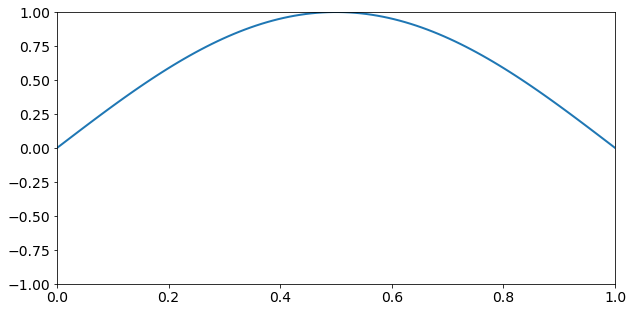

In [14]:
u0 = lambda x: np.sin(np.pi*x)
v0 = lambda x: 0*x

periods = 2
M=2*110*periods

anim = anim_wave(u0,v0, 100, M, T=periods, ylim=(-1,1))
HTML(anim.to_jshtml())

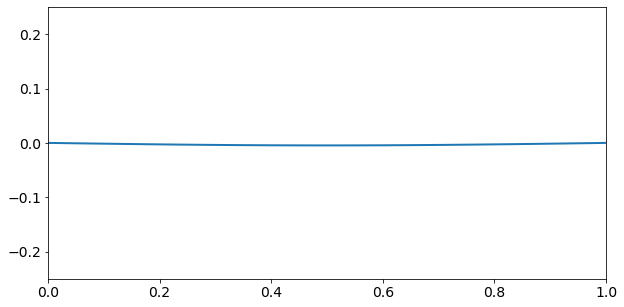

In [10]:
u0 = lambda x: 0*x
v0 = lambda x: np.sin(np.pi*x)

periods = 2
M=2*110*periods

anim = anim_wave(u0,v0, 100, M, T=periods, ylim=(-0.25,0.25))
HTML(anim.to_jshtml())

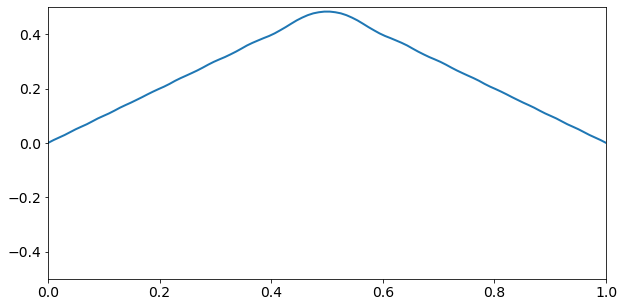

In [11]:
def u0(x):
    xleft = 1.0*(x<0.5)
    xright = 1.0*(x>=0.5)
    return x*xleft + (1.0-x)*xright
v0= lambda x: 0*x

periods = 2
M=2*110*periods

anim = anim_wave(u0,v0, 100, M, T=periods, ylim=(-0.5,0.5))
HTML(anim.to_jshtml())

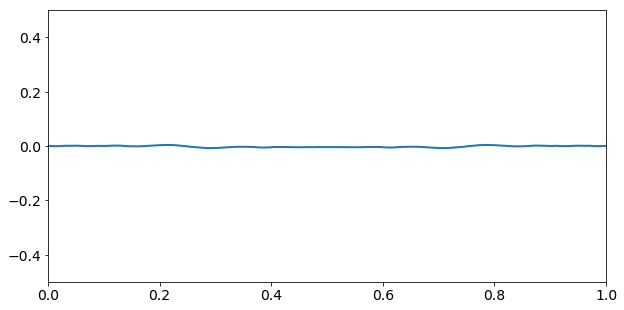

In [240]:
u0 = lambda x: 0*x
v0 = lambda x: 1.0*( np.abs(x-0.5)<0.25 )

periods = 2
M=2*110*periods

anim = anim_wave(u0,v0, 100, M, T=periods, ylim=(-0.5,0.5))
HTML(anim.to_jshtml())

In [7]:
# Utilites for convergence plots.

def linfit(h,err):
    print( err )
    logh = np.log10(h);
    loge = np.log10(err);
    (p,logC) = np.polyfit(logh,loge,deg=1)
    return (10**logC,p)

def convplot(h,*args):
    fits = []
    for y in args:
        fits.append(linfit(h,y[0]))
    
    import matplotlib.pyplot as pp
    for (k,y) in enumerate(args):
        C,p = fits[k]
        pp.loglog(h,y[0],y[1],label="$O(%s^{%f})$" % (y[2],p))        
        pp.loglog(h,C*(h**p))

[0.06320749236038077, 0.031566052128385355, 0.0062901939222605695, 0.003143358624318717, 0.00062839084147435]


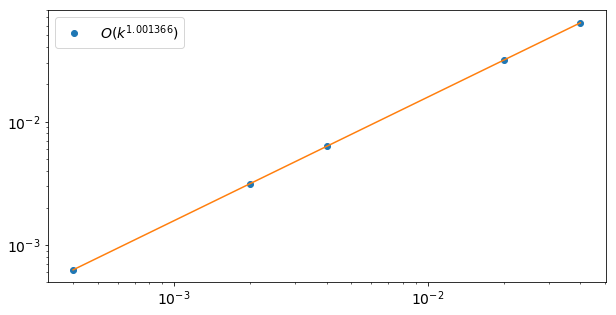

In [245]:
u0=lambda x: np.sin(np.pi*x)
v0= lambda x: 0*x
u_exact = lambda x,t : u0(x)*np.cos(np.pi*t)
T=2
M_list=[50,100,500,1000,5000]
k_list = 2/np.array(M_list)
err = []
for M in M_list:
    N=int(0.9*M/2)
    (x,t,u) = wave_equation(u0,v0,N=N,M=M,T=T)

    (xx,tt) = np.meshgrid(x,t,indexing="ij")
    u_true = u_exact(xx,tt)
    this_err = np.max(np.abs(u-u_true))
    err.append(this_err)
    
convplot(k_list,(err,'o','k'))
pp.legend()

[0.000894645492278412, 0.00022389298123232093, 9.148177075313235e-06, 2.2936094487557845e-06, 9.195952055396361e-08]


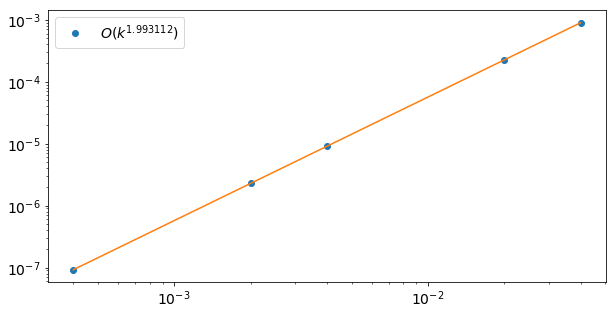

In [246]:
u0= lambda x: 0*x
v0=lambda x: np.sin(np.pi*x)


u_exact = lambda x,t: (1/np.pi)*np.sin(np.pi*x)*np.sin(np.pi*t)

T=2
M_list=[50,100,500,1000,5000]
k_list = T/np.array(M_list)
err = []
for M in M_list:
    N=int(0.9*M/2)
    k = T/M
    (x,t,u) = wave_equation(u0,v0,N=N,M=M,T=T)

    (xx,tt) = np.meshgrid(x,t,indexing="ij")
    u_true = u_exact(xx,tt)
    this_err = np.max(np.abs(u-u_true))
    err.append(this_err)

convplot(k_list,(err,'o','k'))
pp.legend()

In [4]:
def wave_equation_fixed(u0,v0,N,M,T,c=1):
    from scipy import sparse
    k = T/M
    h = 1/(N+1)
    lam = c*k/h

    x = np.linspace(0,1,N+2)
    t = np.linspace(0,T,M+1)
        
    u = np.zeros((N+2,M+1))
    
    u[:,0] = u0(x)

    D = np.zeros((3,N))
    D[0,:] = 1
    D[1,:] = -2
    D[2,:] = 1
    D = sparse.spdiags(D,[-1,0,1],N,N)
    u[1:N+1,1] = u[1:N+1,0]+k*v0(x[1:N+1])+lam*lam/2*D*u[1:N+1,0]
    
    B = np.zeros((3,N))
    B[0,:] = lam*lam
    B[1,:] = 2*(1-lam*lam)
    B[2,:] = lam*lam

    B = sparse.spdiags(B,[1,0,-1],N,N)
    
    for k in range(2,M+1):
        u_pprev = u[1:N+1,k-2]
        u_prev = u[1:N+1,k-1]

        u_next = B.dot(u_prev) - u_pprev
        u[1:N+1,k] = u_next
    return (x,t,u)

[0.0005744051951831752, 0.00014376417837808075, 7.085414240715071e-06, 1.8143437534590134e-06, 7.395888793060301e-08]


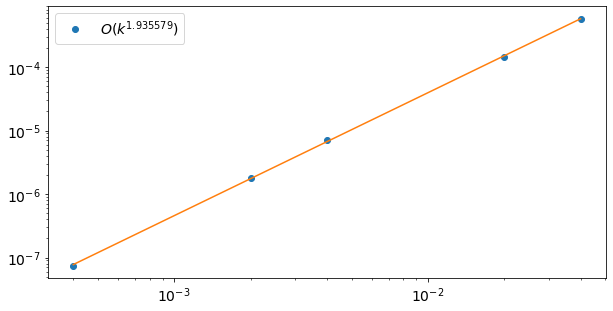

In [8]:
u0=lambda x: np.sin(np.pi*x)
v0= lambda x: 0*x
u_exact = lambda x,t : u0(x)*np.cos(np.pi*t)
T=2
M_list=[50,100,500,1000,5000]
k_list = 2/np.array(M_list)
err = []
for M in M_list:
    N=int(0.9*M/2)
    (x,t,u) = wave_equation_fixed(u0,v0,N=N,M=M,T=T)

    (xx,tt) = np.meshgrid(x,t,indexing="ij")
    u_true = u_exact(xx,tt)
    this_err = np.max(np.abs(u-u_true))
    err.append(this_err)
    
convplot(k_list,(err,'o','k'))
pp.legend()